In [166]:
cam1_imgpoints = [
    (1075, 781),
    (653, 568),
    (864, 680),
    (755, 625),
    (1162, 514),
    (1191, 334),
    (1199, 231),
    (1200, 192),
    (1201, 163),
    (1201, 146),
    (934, 319),
    (1081, 227),
    (1082, 168),
    (527, 672),
    (1112, 696),
    (79, 649),
    ]
cam1_objpoints = [  
    [0, 0, 0],   
    [0, 1, 0], 
    [0, 0.5, 0],
    [0, 0.75, 0],
    [1, 0, 0],
    [0.25 * (4 + 6), 0, 0],
    [0.25 * (4 + 6 + 8), 0, 0],
    [0.25 * (4 + 6 + 8 + 6), 0, 0],
    [0.25 * (4 + 6 + 8 + 6 + 8), 0, 0],
    [0.25 * (4 + 6 + 8 + 6 + 8 + 6), 0, 0],
    [0.25 * (4 + 3 - 1/2), 1, 0],
    [0.25 * (4 + 6 + 4), 0.75, 0],
    [0.25 * (4 + 6 + 8 + 3 - 1/2), 1, 0],
    [0.25 * (-1.5), 1, 0],
    [0.25 * (1), 0, 0],
    [-1.01,1.62, 0]
    ]
cam3_imgpoints = [
    (523, 89),
    (557, 56),
    (624, 42.5),
    (636, 68),
    (649, 97.5),
    (545, 132),
    (584, 129),
    (473, 234.5),
    (734, 282),
    (598, 335),
    (605, 447),
    (360, 674),
    (883, 647),
    (623, 675),
    (616, 585),
    (501, 513),
    (512, 401),
    (851, 563),
    (411, 455),
    (379, 588),
    (370, 190),
]
cam3_objpoints = [
    [0.25 * (4 + 3 - 1/2), 1, 0],
    [0.25 * (4 + 6 + 4), 0.75, 0],
    [0.25 * (4 + 6 + 8), 0, 0],
    [0.25 * (4 + 6), 0, 0],
    [1, 0, 0],
    [0, 0.75, 0],
    [0, 0.5, 0],
    [0.25 * (-4 - 3 - 1/2), 1, 0],
    [0.25 * (-4 - 6), 0, 0],
    [0.25 * (-4 - 6 - 1 - 1/2), 0.5, 0],
    [0.25 * (-4 - 6 - 4), 0.5, 0],
    [0.25 * (-4 - 6 - 4 - 3), 1, 0],
    [0.25 * (-4 - 6 - 4 - 3), 0, 0],
    [0.25 * (-4 - 6 - 4 - 3), 0.5, 0],
    [0.25 * (-4 - 6 - 4 - 2), 0.5, 0],
    [0.25 * (-4 - 6 - 4 - 1), 0.75, 0],
    [0.25 * (-4 - 6 - 3), 0.75, 0],
    [0.25 * (-4 - 6 - 4 - 2), 0, 0],
    [0.25 * (-4 - 6 - 4), 1, 0],
    [0.25 * (-4 - 6 - 4 - 2), 1, 0],
    [-1.01, 1.62, 0]
]

In [167]:
import cv2 
import matplotlib.pyplot as plt
video_path = "data/cam1.mp4"
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    print(f"Error: Could not open video {video_path}")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
duration = total_frames / fps  # Video duration in seconds
print(f"Video FPS: {fps}, Total Frames: {total_frames}, Duration: {duration:.2f}s")

# Limit to the first 10 seconds
max_frames = int(fps * 10)  # Process only the first 10 seconds

# Initialize SORT Tracker

# Output video writer (optional)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(
    "tracked_output.mp4",
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (frame_width, frame_height),
)
ret, frame1 = cap.read()

Video FPS: 14.916666666666666, Total Frames: 53788, Duration: 3605.90s


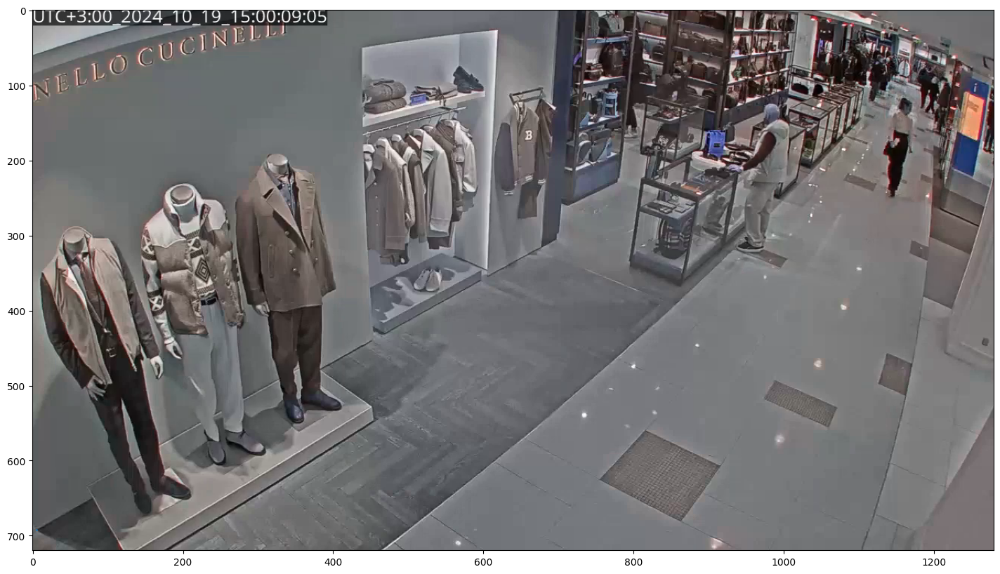

In [168]:
plt.imshow(frame1)
plt.scatter(5, 692, s=1)

/tmp/ipykernel_3272331/1462646156.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


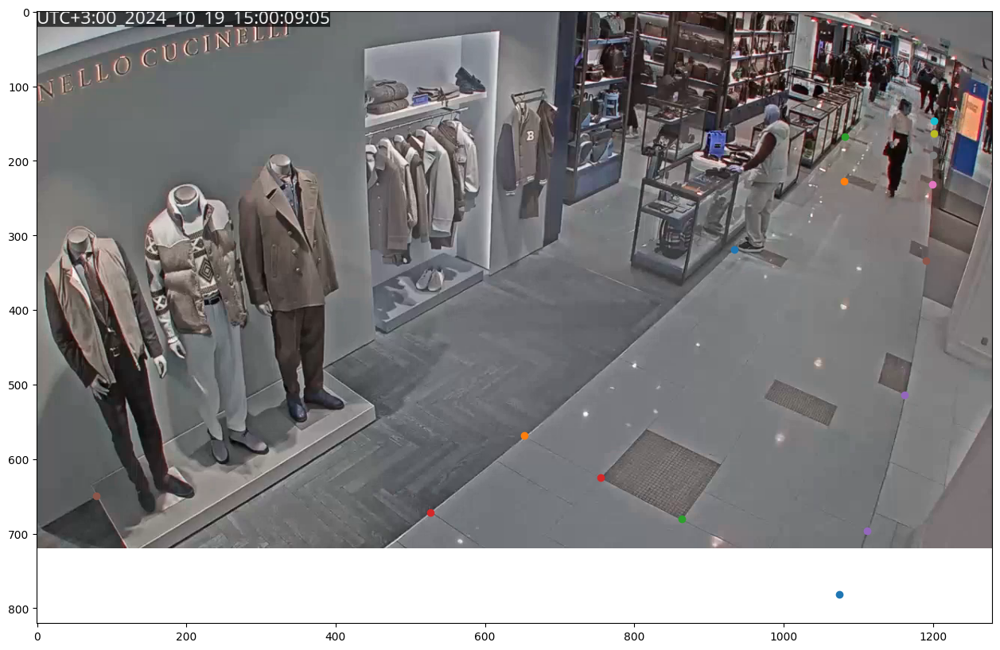

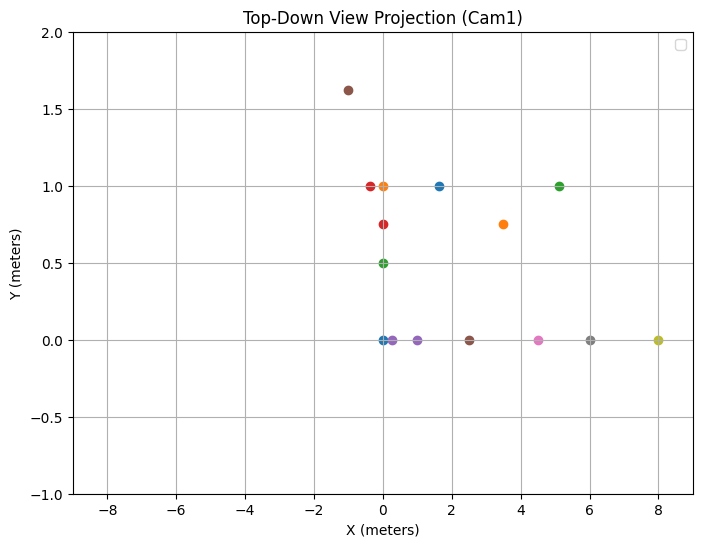

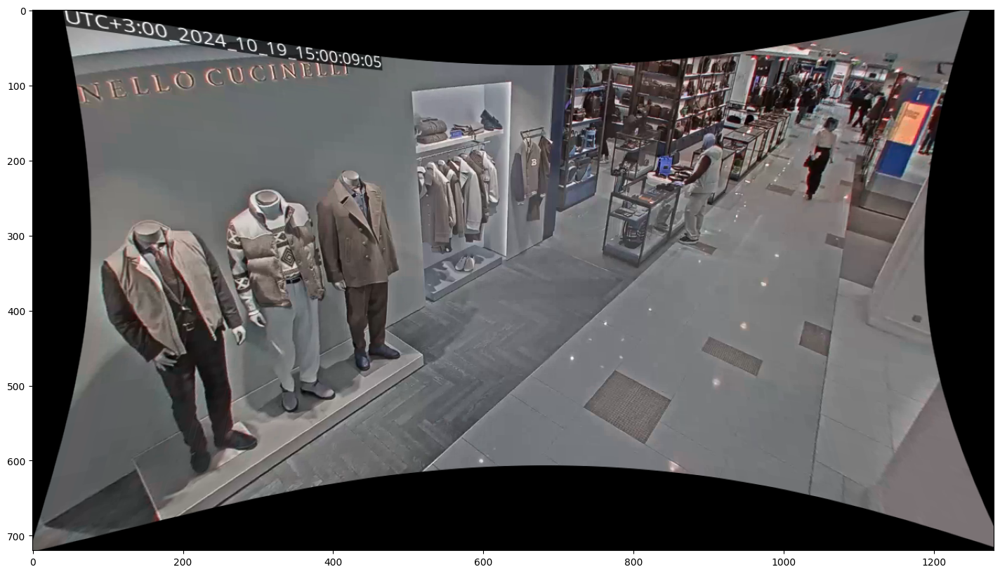

In [169]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20, 10)
plt.imshow(frame1)
for i in cam1_imgpoints:
    plt.scatter(i[0], i[1])
    
plt.figure(figsize=(8, 6))
for i in cam1_objpoints:
    plt.scatter(i[0], i[1])
plt.xlim(-9, 9)  # Adjust based on your top-down space dimensions
plt.ylim(-1, 2)
plt.title("Top-Down View Projection (Cam1)")
plt.xlabel("X (meters)")
plt.ylabel("Y (meters)")
plt.legend()
plt.grid()
plt.show()
# undistort
import numpy as np
gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera([np.array(cam1_objpoints, dtype=np.float32)], [np.array(cam1_imgpoints, dtype=np.float32)], gray.shape[::-1], None, None)
h,  w = frame1.shape[:2]
newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
dst = cv2.undistort(frame1, mtx, dist, None, newcameramtx)
plt.imshow(dst)

In [170]:
import cv2 
import matplotlib.pyplot as plt
video_path = "data/cam3.mp4"
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    print(f"Error: Could not open video {video_path}")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
duration = total_frames / fps  # Video duration in seconds
print(f"Video FPS: {fps}, Total Frames: {total_frames}, Duration: {duration:.2f}s")

# Limit to the first 10 seconds
max_frames = int(fps * 10)  # Process only the first 10 seconds

# Initialize SORT Tracker

# Output video writer (optional)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(
    "tracked_output.mp4",
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (frame_width, frame_height),
)
ret, frame3 = cap.read()

Video FPS: 15.0, Total Frames: 53887, Duration: 3592.47s


In [171]:
for i in range(3000):
    ret, frame3 = cap.read()

KeyboardInterrupt: 

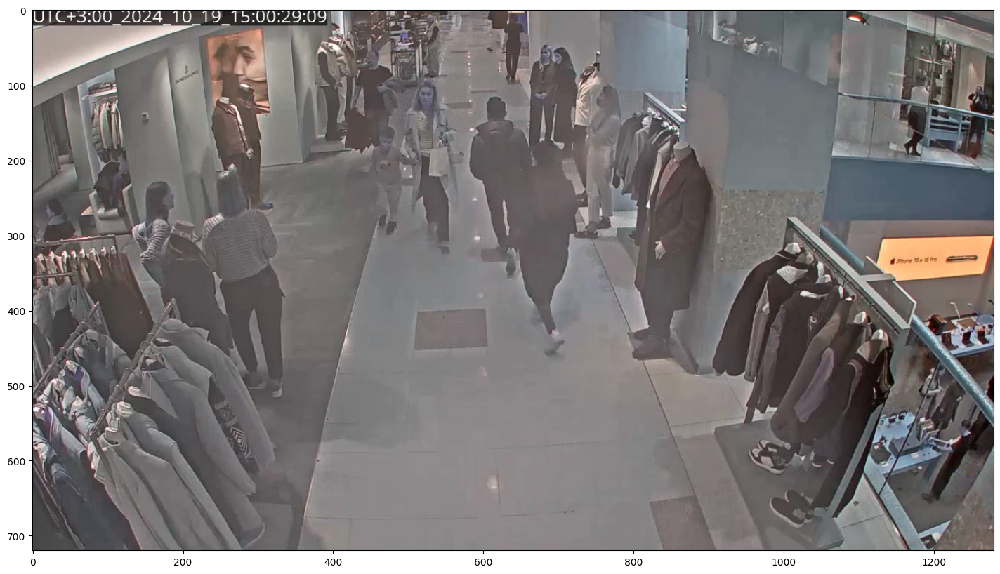

In [178]:
plt.imshow(frame3)
plt.scatter(155, 380, s=1)

/tmp/ipykernel_3269568/2625260459.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


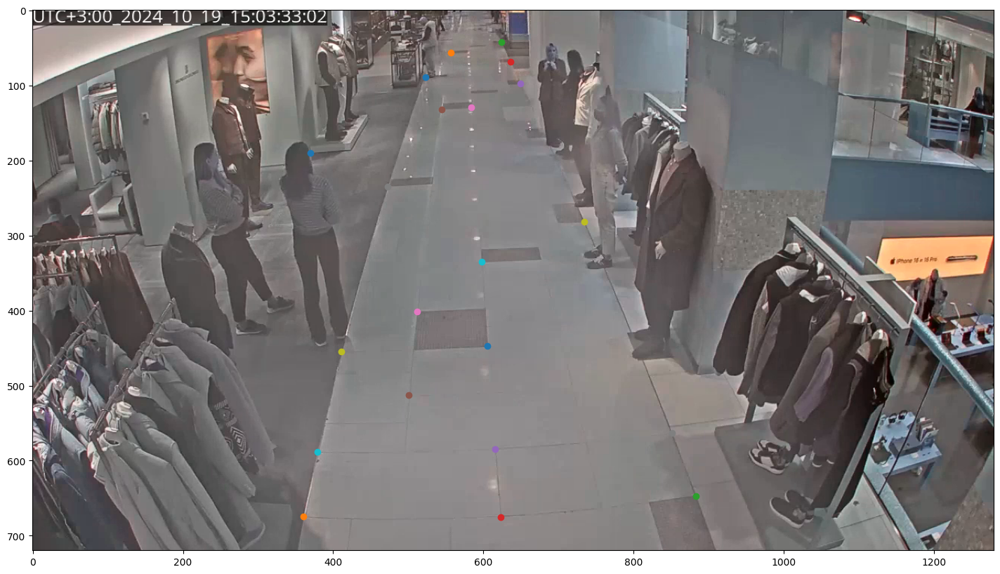

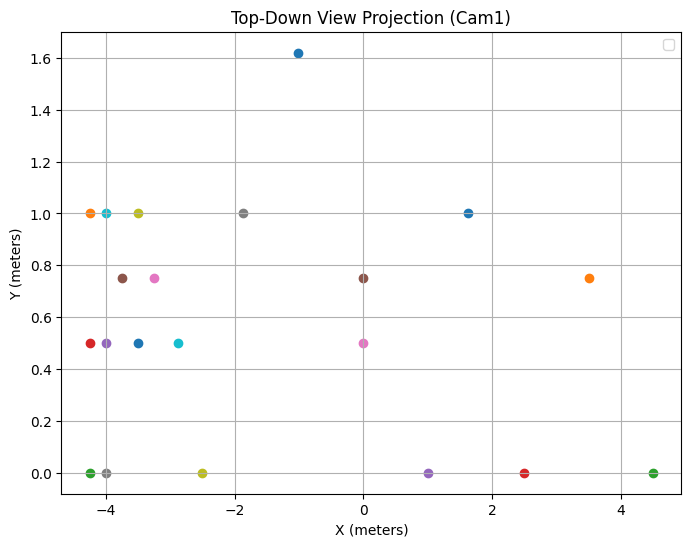

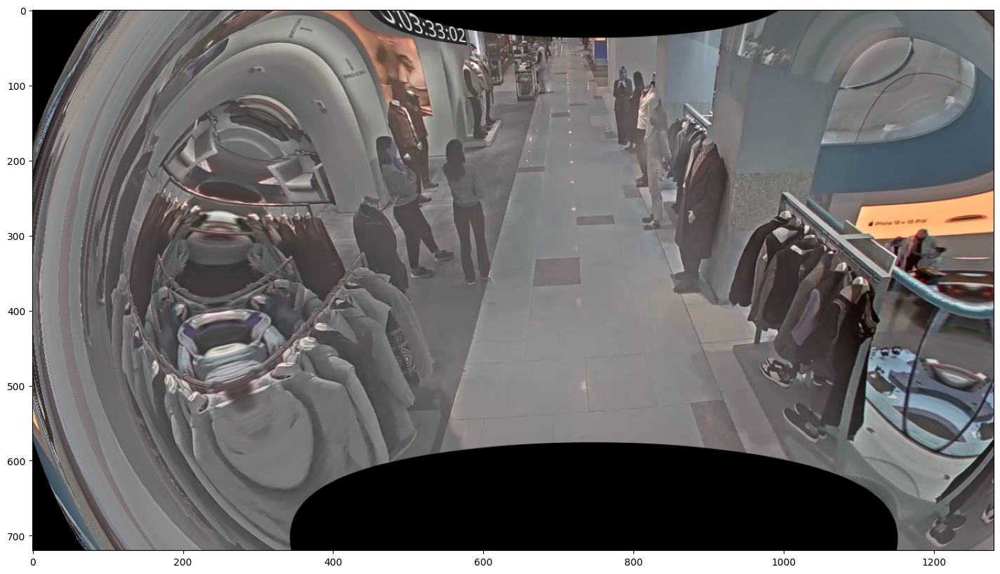

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20, 10)
plt.imshow(frame3)
for i in cam3_imgpoints:
    plt.scatter(i[0], i[1])
    
plt.figure(figsize=(8, 6))
for i in cam3_objpoints:
    plt.scatter(i[0], i[1])
# plt.xlim(-9, 9)  # Adjust based on your top-down space dimensions
# plt.ylim(-1, 2)
plt.title("Top-Down View Projection (Cam1)")
plt.xlabel("X (meters)")
plt.ylabel("Y (meters)")
plt.legend()
plt.grid()
plt.show()
# undistort
import numpy as np
gray = cv2.cvtColor(frame3, cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera([np.array(cam3_objpoints, dtype=np.float32)], [np.array(cam3_imgpoints, dtype=np.float32)], gray.shape[::-1], None, None)
h,  w = frame3.shape[:2]
newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
dst = cv2.undistort(frame3, mtx, dist, None, newcameramtx)
plt.imshow(dst)

In [ ]:
cam3_objpoints

[[1.625, 1, 0],
 [3.5, 0.75, 0],
 [4.5, 0, 0],
 [2.5, 0, 0],
 [1, 0, 0],
 [0, 0.75, 0],
 [0, 0.5, 0],
 [-1.875, 1, 0],
 [-2.5, 0, 0],
 [-2.875, 0.5, 0],
 [-3.5, 0.5, 0],
 [-4.25, 1, 0],
 [-4.25, 0, 0],
 [-4.25, 0.5, 0],
 [-4.0, 0.5, 0],
 [-3.75, 0.75, 0],
 [-3.25, 0.75, 0],
 [-4.0, 0, 0],
 [-3.5, 1, 0],
 [-4.0, 1, 0],
 [-1.01, 1.62, 0]]

In [ ]:
import cv2 
import matplotlib.pyplot as plt
video_path = "data/cam2.mp4"
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    print(f"Error: Could not open video {video_path}")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
duration = total_frames / fps  # Video duration in seconds
print(f"Video FPS: {fps}, Total Frames: {total_frames}, Duration: {duration:.2f}s")

# Limit to the first 10 seconds
max_frames = int(fps * 10)  # Process only the first 10 seconds

# Initialize SORT Tracker

# Output video writer (optional)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(
    "tracked_output.mp4",
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (frame_width, frame_height),
)
ret, frame2 = cap.read()

Video FPS: 15.0, Total Frames: 54765, Duration: 3651.00s


In [ ]:
cam2_imgpoints = [(178, 424),
                  (120, 409),
                  (120, 527),
                  (45, 357),
                  (29, 669),
                  (292, 558),
                  (270, 493),
                  (82, 254),
                  (345, 680),
                  (324, 636),
                  (0, 679),
                  (95, 642),
                  (230, 678),
                  
                  (704, 495),
                  
                  
                  ]
cam2_objpoints = [[-3.25, 0.75, 0],
                  [-3.5, 0.5, 0],
                  [-2.875, 0.5, 0],
                  [-4.25, 0, 0],
                  [-2.5, 0.25 / 2, 0],
                  [-2.5, 1, 0],
                  [-2.75, 1, 0],
                  [-4.25 - 1.5, 0, 0],
                  [-2.5 + 0.25 + 0.25 / 2, 1, 0],
                  [-2.5 + 0.25 , 1, 0],
                  [-2.5, 0, 0],
                  [-2.5, 0.25/2 + 0.25, 0],
                  [-2.5 + 0.25 , 1 - 0.25, 0],
                  
                  [-2.12, 1.91705, 0],
                  
                  ]

In [ ]:
cam2_objpoints

[[-3.25, 0.75, 0],
 [-3.5, 0.5, 0],
 [-2.875, 0.5, 0],
 [-4.25, 0, 0],
 [-2.5, 0.125, 0],
 [-2.5, 1, 0],
 [-2.75, 1, 0],
 [-5.75, 0, 0],
 [-2.125, 1, 0],
 [-2.25, 1, 0],
 [-2.5, 0, 0],
 [-2.5, 0.375, 0],
 [-2.25, 0.75, 0],
 [-2.12, 1.91705, 0]]

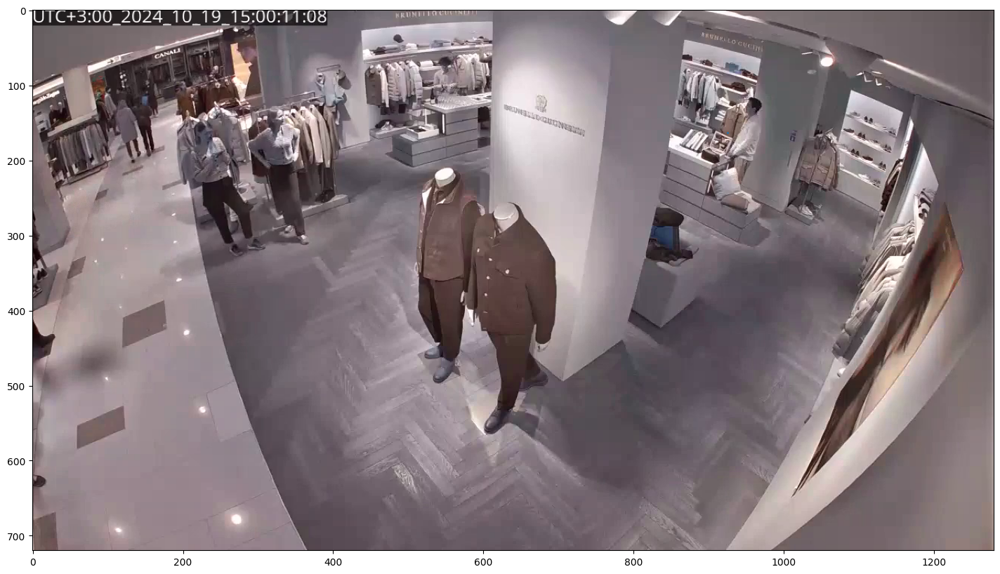

In [ ]:
plt.imshow(frame2)
plt.scatter(925, 163, s=1)


In [ ]:
cam2.transform_image_to_real(980, 631)

NameError: name 'cam2' is not defined

In [ ]:
from camera_calib import Camera
cam2 = Camera("data/calibration2.py")

[[340.32175 336.3754 ]
 [290.60883 326.80814]
 [269.7166  428.88165]
 [225.16899 288.004  ]
 [ 98.02989 614.62427]
 [418.46442 443.43204]
 [409.52008 388.2675 ]
 [264.26865 206.79126]
 [437.51907 566.55774]
 [430.26883 518.05365]
 [ 47.90164 640.9657 ]
 [198.95459 559.0571 ]
 [328.4478  580.08325]
 [725.76215 381.79593]]


In [ ]:
cam2.transform_image_to_real(506, 209)

(-3.7652599811553955, 2.385871171951294)

In [ ]:
cam1.transform_image_to_real(5, 692)

NameError: name 'cam1' is not defined

In [ ]:
cam3.transform_image_to_real(359, 203)

NameError: name 'cam3' is not defined

In [ ]:
cam3.transform_image_to_real(253, 266)

NameError: name 'cam3' is not defined

In [ ]:
for i in range(1000):
    ret, frame2 = cap.read()

/tmp/ipykernel_3269568/2617777323.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


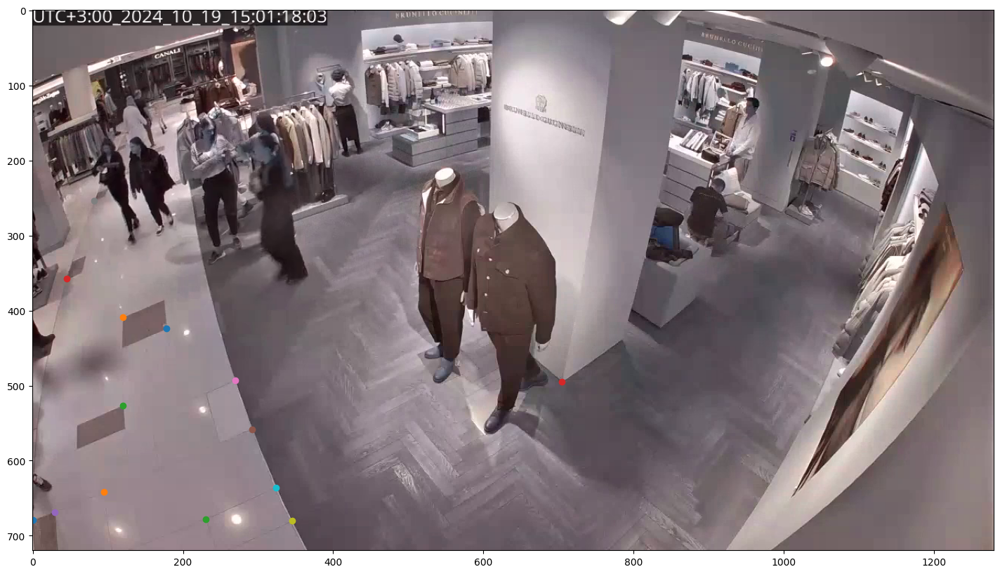

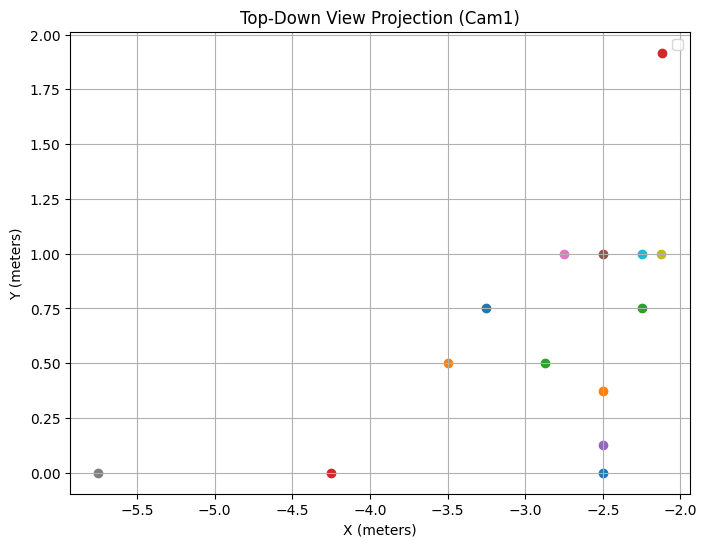

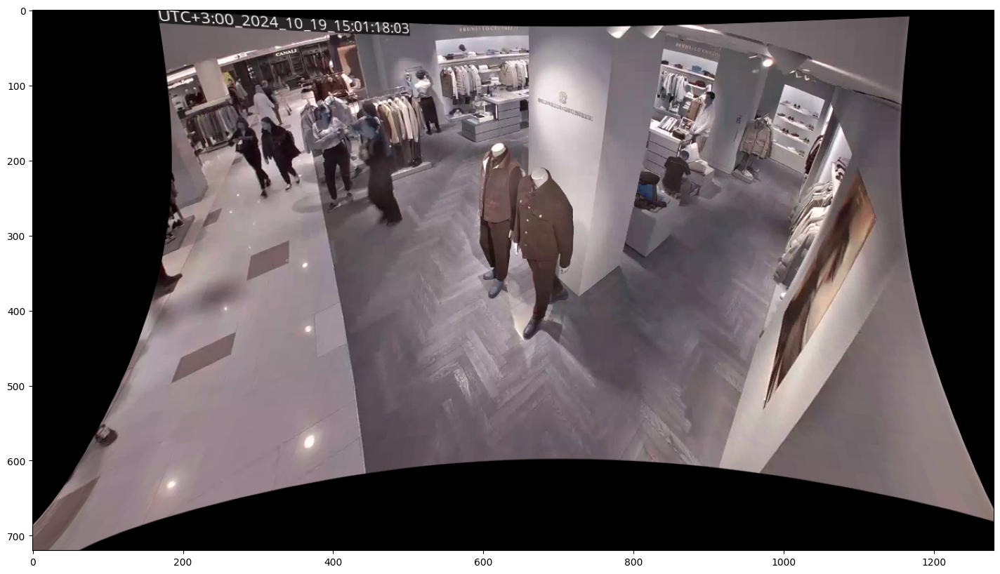

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20, 10)
plt.imshow(frame2)
for i in cam2_imgpoints:
    plt.scatter(i[0], i[1])
    
plt.figure(figsize=(8, 6))
for i in cam2_objpoints:
    plt.scatter(i[0], i[1])
# plt.xlim(-9, 9)  # Adjust based on your top-down space dimensions
# plt.ylim(-1, 2)
plt.title("Top-Down View Projection (Cam1)")
plt.xlabel("X (meters)")
plt.ylabel("Y (meters)")
plt.legend()
plt.grid()
plt.show()
# undistort
import numpy as np
gray = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera([np.array(cam2_objpoints, dtype=np.float32)], [np.array(cam2_imgpoints, dtype=np.float32)], gray.shape[::-1], None, None)
h,  w = frame2.shape[:2]
newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
dst = cv2.undistort(frame2, mtx, dist, None, newcameramtx)
plt.imshow(dst)

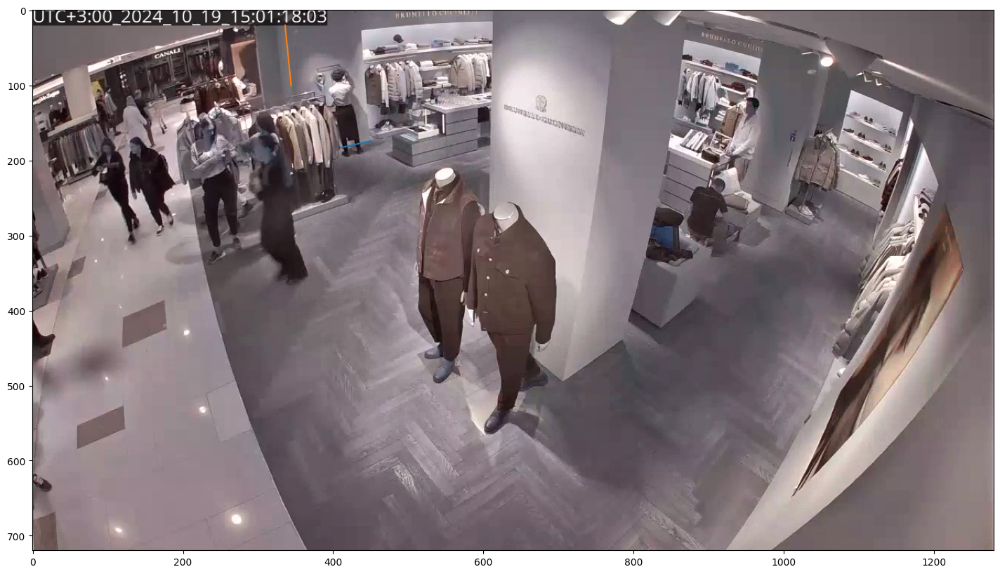

In [ ]:
plt.imshow(frame2)
plt.scatter(450, 174, s=1)
plt.scatter(410, 183, s=1)
plt.scatter(344, 100, s=1)
plt.scatter(336, 20, s=1)

plt.plot([410, 450],[183, 174])
plt.plot([344, 336], [100, 20])
plt.scatter(353.5, 195.7, s=1)

In [ ]:
import cv2 
import matplotlib.pyplot as plt
video_path = "data/cam4.mp4"
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    print(f"Error: Could not open video {video_path}")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
duration = total_frames / fps  # Video duration in seconds
print(f"Video FPS: {fps}, Total Frames: {total_frames}, Duration: {duration:.2f}s")

# Limit to the first 10 seconds
max_frames = int(fps * 10)  # Process only the first 10 seconds

# Initialize SORT Tracker

# Output video writer (optional)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(
    "tracked_output.mp4",
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (frame_width, frame_height),
)
ret, frame4 = cap.read()

Video FPS: 15.0, Total Frames: 53885, Duration: 3592.33s


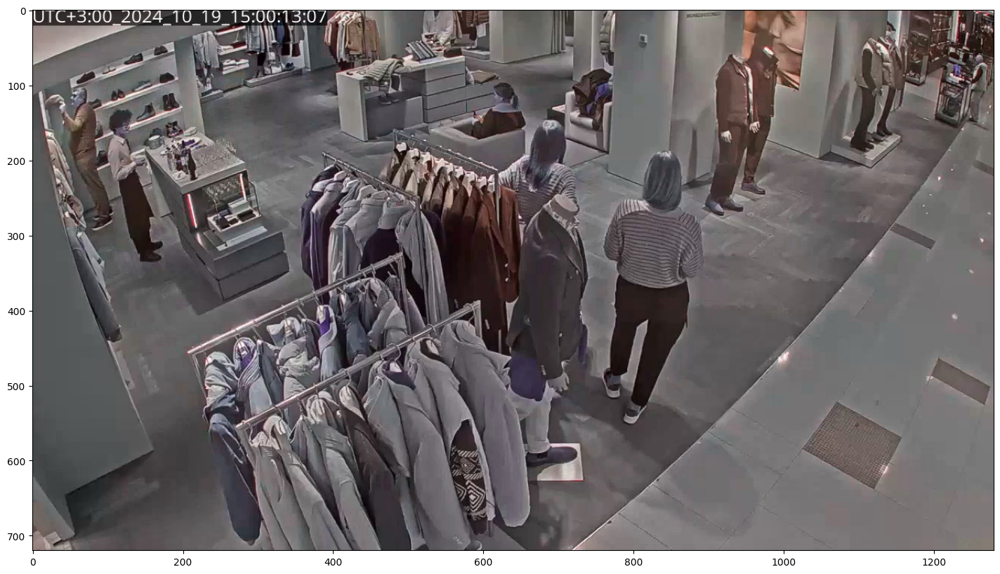

In [ ]:
plt.imshow(frame4)  

In [ ]:
cam4_imgpoints = [(1024, 584),
                  (1120, 638),
                  (1157, 570),
                  (1196, 487),
                  (1274, 501),
                  (1060, 388),
                  (1086, 356),
                  
                  (778, 670),
                  (824, 630),
                  (1140, 293),
                  (1200, 308),
                  (1251, 208),
                  
                  (1062, 188),
                  (1243, 149),
                  
                  (343, 346),
                  
                  (1209, 688),
                  
                  (160, 585),
                  
                  (897, 560),
                  (929, 529),
                  ]
cam4_objpoints = [[-3.5, 0.75, 0], 
                  [-3.5, 0.5, 0],
                  [-3.5 + 0.25, 0.5, 0],
                  [-2.875, 0.5, 0],
                  [-2.75, 0.25, 0],
                  [-2.75, 1, 0],
                  [-2.5, 1, 0],
                  
                  [-4, 1, 0],
                  [-4 + 0.25/2, 1, 0],
                  [-1.875, 1, 0],
                  [-1.75, 0.75, 0],
                  [0, 0.75, 0],
                  
                  [-1.01, 1.62, 0],
                  [1.625, 1, 0],
                  
                  [-3.76526, 2.3858712, 0],
                  
                  [-3.5, 0.25, 0],
                  
                  [-4.70901, 1.8782753, 0],
                  
                  [-3.5 - 0.25/2, 1, 0],
                  [-3.5, 1, 0],
                  ]

In [ ]:
-2.875 + 0.25/2

-2.75

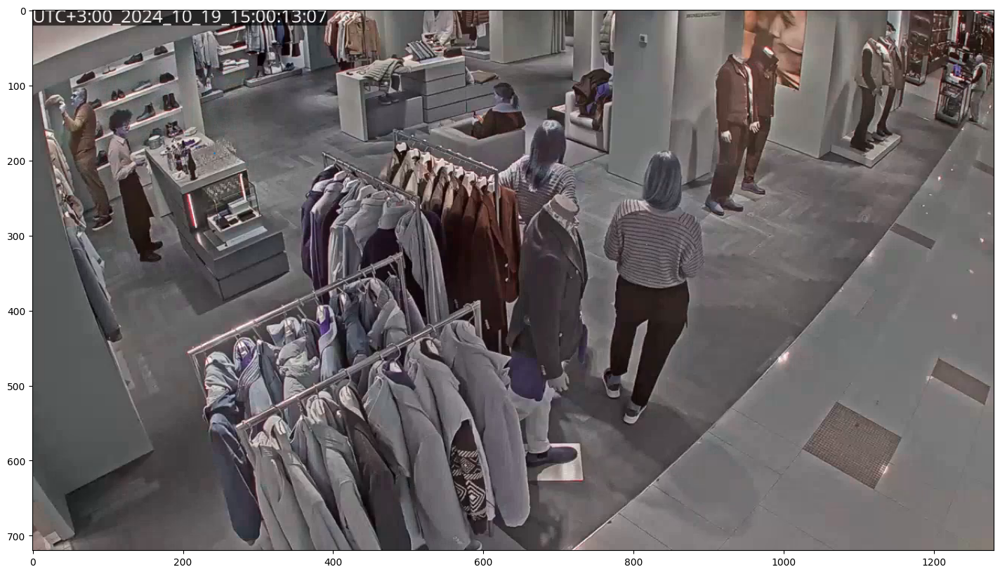

In [ ]:
plt.imshow(frame4)
plt.scatter(242, 190, s=1)

/tmp/ipykernel_3272331/1863607361.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


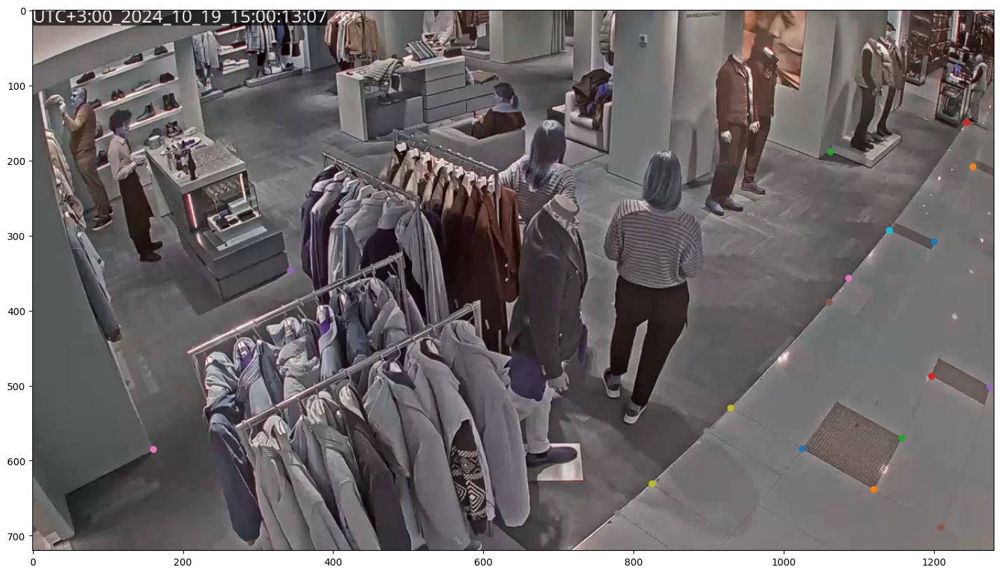

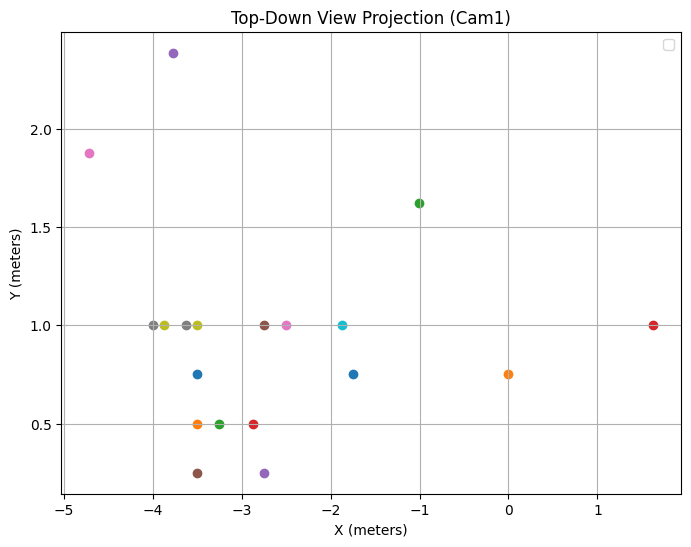

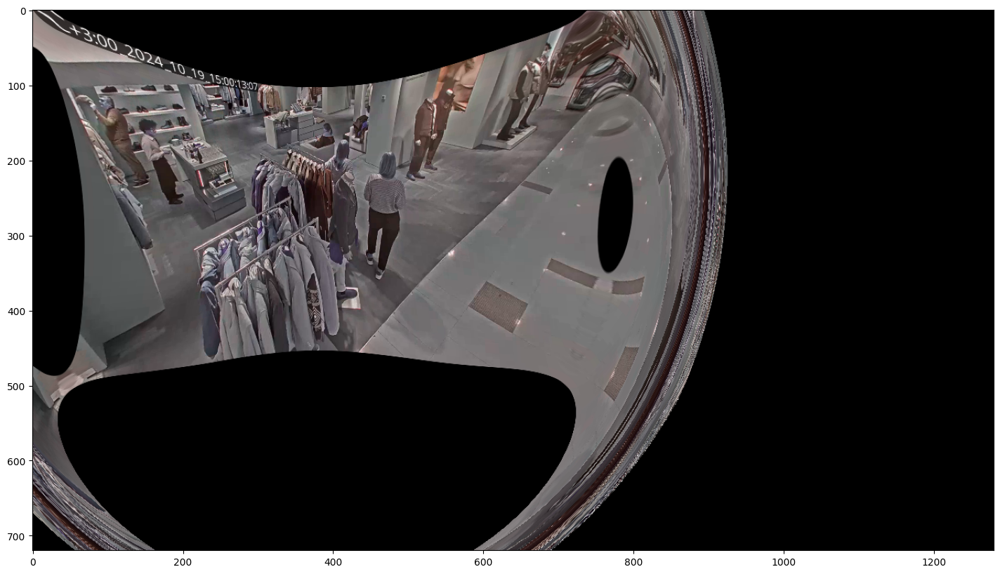

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20, 10)
plt.imshow(frame4)
for i in cam4_imgpoints:
    plt.scatter(i[0], i[1])
    
plt.figure(figsize=(8, 6))
for i in cam4_objpoints:
    plt.scatter(i[0], i[1])
# plt.xlim(-9, 9)  # Adjust based on your top-down space dimensions
# plt.ylim(-1, 2)
plt.title("Top-Down View Projection (Cam1)")
plt.xlabel("X (meters)")
plt.ylabel("Y (meters)")
plt.legend()
plt.grid()
plt.show()
# undistort
import numpy as np
gray = cv2.cvtColor(frame4, cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera([np.array(cam4_objpoints, dtype=np.float32)], [np.array(cam4_imgpoints, dtype=np.float32)], gray.shape[::-1], None, None)
h,  w = frame4.shape[:2]
newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
dst = cv2.undistort(frame4, mtx, dist, None, newcameramtx)
plt.imshow(dst)

In [ ]:
from camera_calib import Camera

In [ ]:
cam1 = Camera('data/calibration1.py')
cam2 = Camera('data/calibration2.py')
cam3 = Camera('data/calibration3.py')

[[1029.4076   691.4486 ]
 [ 682.1438   480.70346]
 [ 831.45056  568.73956]
 [ 751.7438   522.4469 ]
 [1067.2269   459.0751 ]
 [1088.1649   323.0823 ]
 [1101.0782   244.00163]
 [1105.8704   212.95782]
 [1110.5193   189.19675]
 [1112.9305   175.02191]
 [ 871.7962   314.25705]
 [ 988.51465  247.3    ]
 [ 993.20233  203.45639]
 [ 592.14825  560.9431 ]
 [1046.0125   610.0285 ]]
[[340.32175 336.3754 ]
 [290.60883 326.80814]
 [269.7166  428.88165]
 [225.16899 288.004  ]
 [ 98.02989 614.62427]
 [418.46442 443.43204]
 [409.52008 388.2675 ]
 [264.26865 206.79126]
 [437.51907 566.55774]
 [430.26883 518.05365]
 [ 47.90164 640.9657 ]
 [198.95459 559.0571 ]
 [328.4478  580.08325]
 [725.76215 381.79593]]
[[674.43506  110.02188 ]
 [696.52014   84.45447 ]
 [741.2817    73.912605]
 [749.24475   94.403725]
 [757.7064   117.2093  ]
 [689.70496  142.7954  ]
 [715.19196  140.8192  ]
 [643.8603   216.10954 ]
 [811.42615  249.53125 ]
 [724.66595  286.3597  ]
 [728.95374  363.7284  ]
 [553.7548   544.9003  ]
 

In [ ]:
cam4 = Camera('data/calibration4.py')


[[579.6043  393.86176]
 [638.7322  430.07767]
 [659.54486 391.84198]
 [683.87854 344.33954]
 [746.8607  354.32358]
 [591.52625 286.44638]
 [608.4809  269.63055]
 [458.76697 427.10358]
 [477.61285 405.42294]
 [648.1391  233.29866]
 [691.20514 238.80632]
 [741.64874 168.56886]
 [596.8863  178.28566]
 [745.3695  126.95844]
 [285.21817 259.94827]
 [708.05206 470.65848]
 [175.64163 397.71313]
 [508.1991  369.84903]
 [522.4569  354.8797 ]]


In [ ]:
cam2.transform_image_to_real(353.5, 195.7)

(-4.709010124206543, 1.8782752752304077)

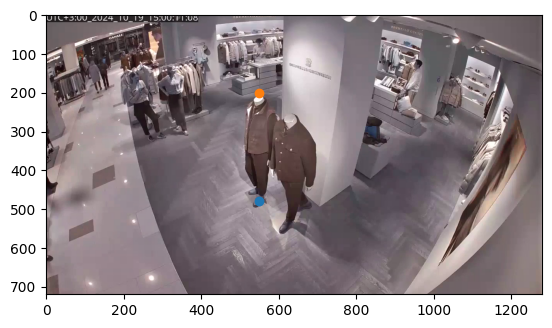

In [ ]:
plt.imshow(frame2)
plt.scatter(550, 480)
plt.scatter(550, 200)

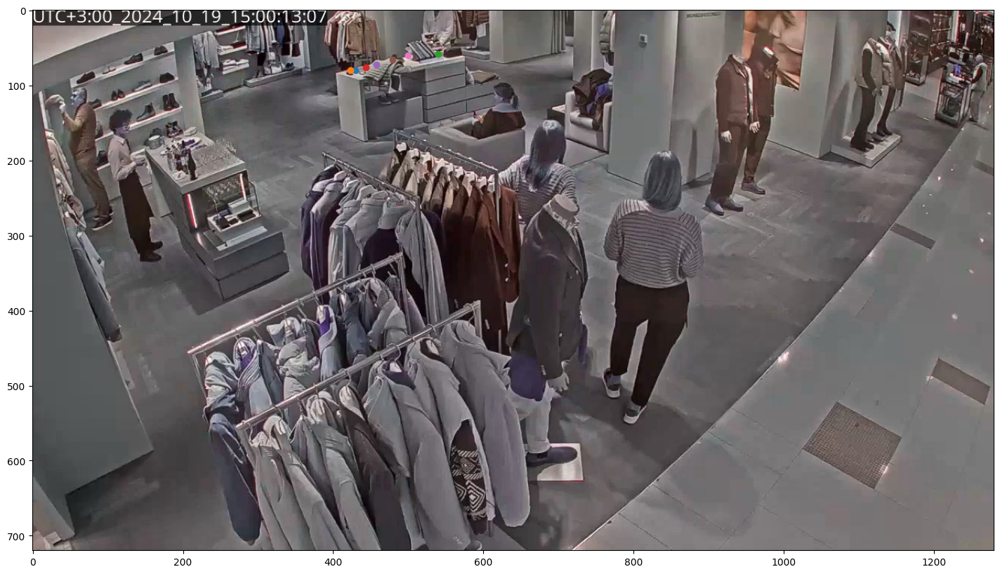

In [ ]:
plt.scatter(430, 80)
plt.scatter(423, 80)
plt.scatter(540, 58)
plt.scatter(444, 76)
plt.scatter(458, 72)
plt.scatter(479, 66)
plt.scatter(500, 60)

plt.imshow(frame4)

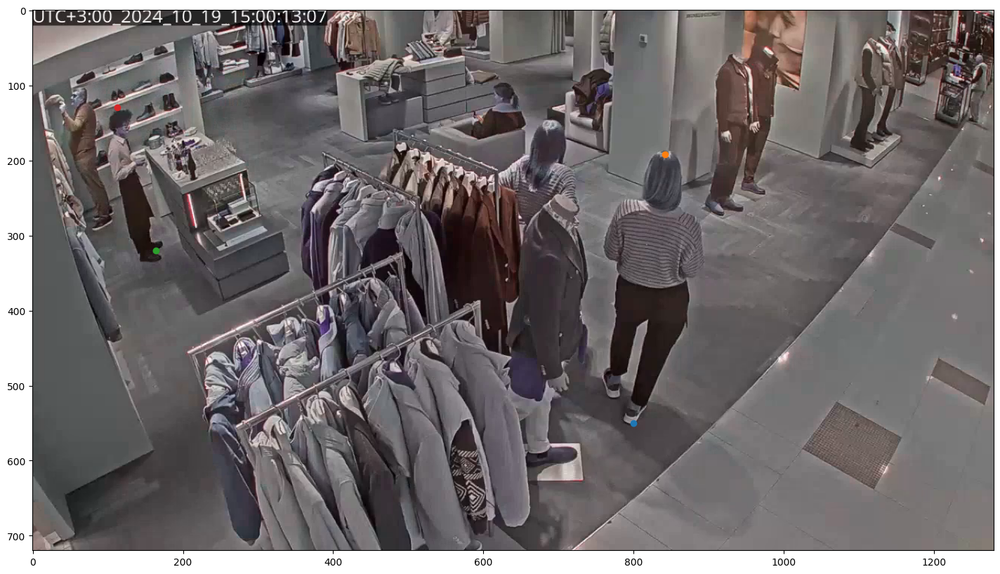

In [ ]:
# plt.imshow(frame4)
plt.scatter(800, 550)
plt.scatter(842, 192)
plt.imshow(frame4)
plt.scatter(164, 320)
plt.scatter(113, 129)

In [ ]:
cam4.transform_image_to_world(113, 129, 0.73)

[[-0.4460471 ]
 [-0.10730494]
 [ 1.        ]]
[[ 0.38259386]
 [ 0.98554813]
 [-0.30461318]]
[[-5.30138211]
 [ 0.23490679]
 [ 1.43080998]]


(-4.421165448140283, 2.502313512002943)

In [ ]:
cam4.transform_image_to_real(164, 320)

(-4.1103315353393555, 2.940493583679199)

In [ ]:
cam2.transform_image_to_world(550, 480, 0.1)

[[ 0.5660066 ]
 [-1.51368231]
 [-1.20314143]]
[[-2.50944102]
 [ 2.09692422]
 [ 0.33689316]]


(-2.397996853896362, 1.798886946517457)

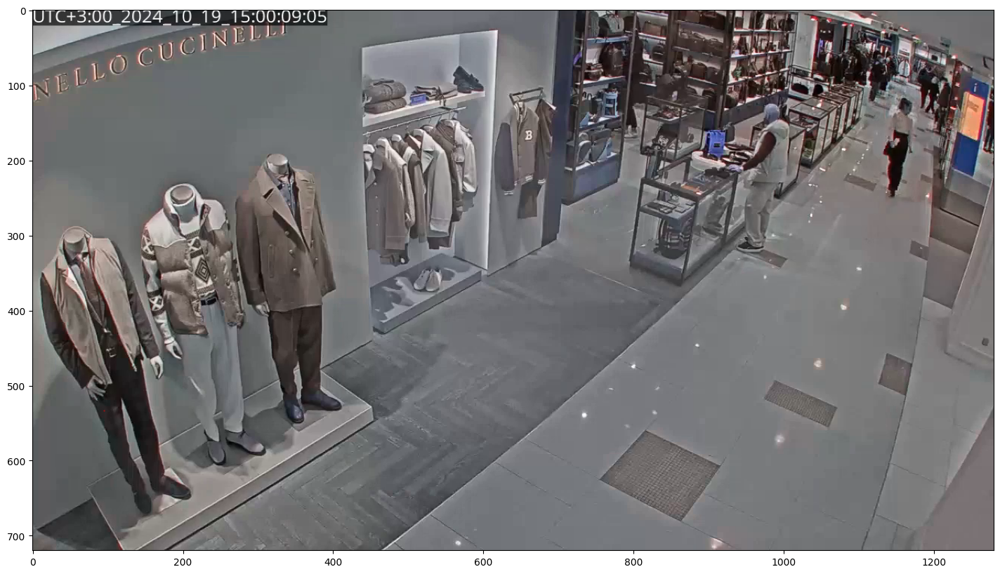

In [ ]:
test_p1 = (95, 533)
plt.imshow(frame1)
plt.scatter(test_p1[0], test_p1[1], s=0.1, c='red')

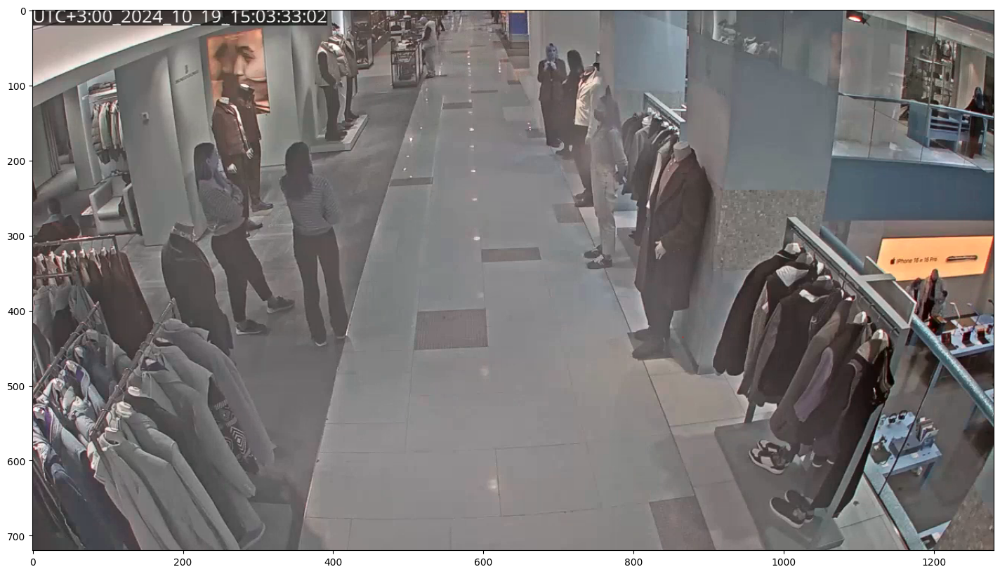

In [ ]:
test_p3 = (865, 435)
plt.imshow(frame3)
plt.scatter(test_p3[0], test_p3[1], s= 0.1, c ='red')

In [ ]:
cam3.transform_image_to_real(*test_p3)

(-3.5302670001983643, -0.17396579682826996)

In [ ]:
!pip install torchreid


[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: python -m pip install --upgrade pip


In [ ]:
!pip install tensorboard

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 28.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.7/133.7 kB 45.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 88.4 MB/s eta 0:00:00ta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 112.6 MB/s eta 0:00:00 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 79.7 MB/s eta 0:00:00

[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: python -m pip install --upgrade pip


In [ ]:
!pip install boxmot

  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 13.1 MB/s eta 0:00:00 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 17.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 40.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.6/61.6 kB 26.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 63.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 33.7 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 8.5 MB/s eta 0:00:00:00:0100:01
Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 2.6 MB/s eta 0:00:0000:01m0:03m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.9/167.9 MB 24.5 MB/s eta 0:00:0000:010:05m
  Attempting uninstall: triton
    Found existin

In [ ]:
import cv2
import gdown
import torch
import numpy as np
from pathlib import Path
from torchvision import transforms
from ultralytics.utils import ops

# from yolox.exp import get_exp
# from yolox.utils import postprocess
# from yolox.utils.model_utils import fuse_model
from boxmot import BotSort
from boxmot.utils.ops import yolox_preprocess


# # Dictionary for YOLOX model weights URLs
# YOLOX_ZOO = {
#     'yolox_n.pt': 'https://drive.google.com/uc?id=1AoN2AxzVwOLM0gJ15bcwqZUpFjlDV1dX',
#     'yolox_s.pt': 'https://drive.google.com/uc?id=1uSmhXzyV1Zvb4TJJCzpsZOIcw7CCJLxj',
#     'yolox_m.pt': 'https://drive.google.com/uc?id=11Zb0NN_Uu7JwUd9e6Nk8o2_EUfxWqsun',
#     'yolox_l.pt': 'https://drive.google.com/uc?id=1XwfUuCBF4IgWBWK2H7oOhQgEj9Mrb3rz',
#     'yolox_x.pt': 'https://drive.google.com/uc?id=1P4mY0Yyd3PPTybgZkjMYhFri88nTmJX5',
# }

# # Preprocessing pipeline
# input_size = [800, 1440]
device = torch.device('cpu')
# yolox_model = 'yolo11x.pt'
# yolox_model_path = Path(yolox_model)

# # Download model if not present
# if not yolox_model_path.exists():
#     gdown.download(YOLOX_ZOO[yolox_model], output=str(yolox_model_path), quiet=False)

# # Initialize YOLOX model
# exp = get_exp(None, yolox_model)
# exp.num_classes = 1
# ckpt = torch.load(yolox_model_path, map_location=device)

# model = exp.get_model()
# model.load_state_dict(ckpt["model"])
# model = fuse_model(model).to(device).eval()

# Initialize tracker
tracker = BotSort(reid_weights=Path('osnet_x0_25_msmt17.pt'), device=device, half=False)


2025-03-16 13:46:14.199 | INFO     | boxmot.utils.torch_utils:select_device:52 - Yolo Tracking v12.0.0 🚀 Python-3.10.12 torch-2.2.2+cu121CPU
Downloading...
From: https://drive.google.com/uc?id=1sSwXSUlj4_tHZequ_iZ8w_Jh0VaRQMqF
To: /root/temp/osnet_x0_25_msmt17.pt
100%|██████████| 3.06M/3.06M [00:00<00:00, 11.0MB/s]
2025-03-16 13:46:18.882 | SUCCESS  | boxmot.appearance.reid_model_factory:load_pretrained_weights:183 - Loaded pretrained weights from osnet_x0_25_msmt17.pt


In [ ]:
!pip install yolox

  Using cached yolox-0.3.0.tar.gz (79 kB)
  Preparing metadata (setup.py) ... done
  Using cached scikit_image-0.25.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (14 kB)
  Using cached thop-0.1.1.post2209072238-py3-none-any.whl.metadata (2.7 kB)
  Using cached ninja-1.11.1.3-py3-none-manylinux_2_12_x86_64.manylinux2010_x86_64.whl.metadata (5.3 kB)
  Using cached onnx-1.8.1.tar.gz (5.2 MB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
INFO: pip is looking at multiple versions of yolox to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.0/66.0 kB 1.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... error
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [8 lines of output]
   

In [ ]:
tracker.model.get_features(np.array([[0, 0, 100, 100]]), frame1).shape

(1, 512)

In [ ]:
frame1

array([[[ 52,  52,  52],
        [ 54,  54,  54],
        [215, 215, 215],
        ...,
        [105, 109, 111],
        [105, 109, 111],
        [105, 109, 111]],

       [[ 52,  52,  52],
        [ 54,  54,  54],
        [215, 215, 215],
        ...,
        [105, 109, 111],
        [105, 109, 111],
        [105, 109, 111]],

       [[ 52,  52,  52],
        [ 54,  54,  54],
        [215, 215, 215],
        ...,
        [105, 109, 111],
        [105, 109, 111],
        [105, 109, 111]],

       ...,

       [[ 96,  94,  90],
        [ 96,  94,  90],
        [ 96,  94,  90],
        ...,
        [122, 114, 116],
        [122, 114, 116],
        [122, 114, 116]],

       [[ 96,  94,  90],
        [ 96,  94,  90],
        [ 96,  94,  90],
        ...,
        [122, 114, 116],
        [122, 114, 116],
        [122, 114, 116]],

       [[ 96,  94,  90],
        [ 96,  94,  90],
        [ 96,  94,  90],
        ...,
        [122, 114, 116],
        [122, 114, 116],
        [122, 114, 116]]